# Space Invaders

In [1]:
# imports
import gym
import matplotlib.pyplot as plt
%matplotlib inline
from IPython.display import display

# for getting the videos
from matplotlib import rc
import matplotlib.animation as animation
rc('animation', html='jshtml')

# getting the evolutionary strategies
import ray.rllib.agents.es as es
# import subprocess to copy the checkpoints
import subprocess
import pickle
from ray import tune
import ray

/usr/local/lib/python3.8/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


## Random movements

In [2]:
env = gym.make('SpaceInvaders-v4')

obs, info = env.reset(return_info=True)

vid = []
# some inspiration from https://www.gymlibrary.ml/content/api/
for _ in range(1000):   
    obs, reward, done, info = env.step(env.action_space.sample())
    vid.append(env.render(mode="rgb_array"))
    if done:
        break
env.close()

# using code from Computer vision lab 5, animation
fig, ax = plt.subplots()
def frame(i: int):
    """Render a frame of video"""
    # dispose of the last frame
    ax.clear()
    # get rid of the axis labels
    ax.axis('off')
    fig.tight_layout()
    # render the agent's view
    return ax.imshow(vid[i])

# build up the video
anim = animation.FuncAnimation(fig, frame, frames=len(vid))
# dispose of the graph object so that the last frame of the video isn't returned
plt.close()
anim

A.L.E: Arcade Learning Environment (version 0.7.4+069f8bd)
[Powered by Stella]


## Evolutionary Strategies

In [14]:
# get the es config
config = es.DEFAULT_CONFIG.copy()

config['framework'] = 'torch'

# stop it from checking the environment
config['disable_env_checking'] = True
# suppress an error
#config['reuse_actors'] = True
config['env'] = 'SpaceInvaders-v4'
config['num_workers'] = 5

In [16]:
ray.init(num_cpus=6)
# use tune
stop = {
    "episode_reward_mean": 500,
}
# using code inspired from https://github.com/ray-project/ray/blob/master/rllib/examples/inference_and_serving/policy_inference_after_training.py
results = tune.run(
    "ES",
    config=config,
    stop=stop,
    verbose=2,
    checkpoint_freq=1,
    checkpoint_at_end=True,
    #resources_per_trial={"cpu": 6, "gpu": 0},
    #resources_per_trial=tune.PlacementGroupFactory([{"cpu": 6, "gpu": 0}]),
)
# completed training
checkpoint = results.get_last_checkpoint()
# copy the checkpoints to file
subprocess.run(['cp', checkpoint, 'data/SpaceInvadersES/tune/'], stderr=subprocess.PIPE)
subprocess.run(['cp', checkpoint + '.tune_metadata', 'data/SpaceInvadersES/tune/'], stderr=subprocess.PIPE)
ray.shutdown()

2022-04-22 07:57:51,483	WARNING services.py:1983 -- WARNING: The object store is using /tmp instead of /dev/shm because /dev/shm has only 67108864 bytes available. This will harm performance! You may be able to free up space by deleting files in /dev/shm. If you are inside a Docker container, you can increase /dev/shm size by passing '--shm-size=3.39gb' to 'docker run' (or add it to the run_options list in a Ray cluster config). Make sure to set this to more than 30% of available RAM.
2022-04-22 07:57:53,156	INFO trial_runner.py:803 -- starting ES_SpaceInvaders-v4_e989d_00000
(ESTrainer pid=3450) A.L.E: Arcade Learning Environment (version 0.7.4+069f8bd)
(ESTrainer pid=3450) [Powered by Stella]
(ESTrainer pid=3450) 2022-04-22 07:57:56,679	INFO torch_policy.py:183 -- TorchPolicy (worker=local) running on CPU.
(ESTrainer pid=3450) 2022-04-22 07:57:57,653	INFO es.py:275 -- Creating shared noise table.


(ESTrainer pid=3450) 2022-04-22 07:58:07,998	INFO es.py:280 -- Creating actors.
(ESTrainer pid=3450) 2022-04-22 07:58:08,040	INFO trainable.py:152 -- Trainable.setup took 11.886 seconds. If your trainable is slow to initialize, consider setting reuse_actors=True to reduce actor creation overheads.
(ESTrainer pid=3450) 2022-04-22 07:58:08,041	WARNING util.py:60 -- Install gputil for GPU system monitoring.
(ESTrainer pid=3450) 2022-04-22 07:58:10,577	INFO es.py:424 -- Collected 0 episodes 0 timesteps so far this iter
(Worker pid=3555) A.L.E: Arcade Learning Environment (version 0.7.4+069f8bd)
(Worker pid=3555) [Powered by Stella]
(Worker pid=3559) A.L.E: Arcade Learning Environment (version 0.7.4+069f8bd)
(Worker pid=3559) [Powered by Stella]
(Worker pid=3560) A.L.E: Arcade Learning Environment (version 0.7.4+069f8bd)
(Worker pid=3560) [Powered by Stella]
(Worker pid=3556) A.L.E: Arcade Learning Environment (version 0.7.4+069f8bd)
(Worker pid=3556) [Powered by Stella]
(Worker pid=3555) 2

(Worker pid=3554) /usr/local/lib/python3.8/site-packages/ray/rllib/agents/es/es_torch_policy.py:37: UserWarning: The given NumPy array is not writable, and PyTorch does not support non-writable tensors. This means writing to this tensor will result in undefined behavior. You may want to copy the array to protect its data or make it writable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  ../torch/csrc/utils/tensor_numpy.cpp:178.)
(Worker pid=3554)   new_theta_dict[k] = torch.from_numpy(


In [15]:
ray.shutdown()

In [14]:
trainer = es.ESTrainer(config, env='SpaceInvaders-v4')
mean_reward = []
for ep in range(25):
    result = trainer.train()
    print(f"Episode {ep}, mean reward: {result['episode_reward_mean']}")
    checkpoint = trainer.save()
    # copy the checkpoints to file
    subprocess.run(['cp', checkpoint, 'data/SpaceInvadersES/'], stderr=subprocess.PIPE)
    subprocess.run(['cp', checkpoint + '.tune_metadata', 'data/SpaceInvadersES/'], stderr=subprocess.PIPE)
    # append the rewards
    mean_reward.append(result['episode_reward_mean'])
    # save the rewards to file
    with open('data/SpaceInvadersRewards.pkl', 'wb') as f:
        pickle.dump(mean_reward, f)

2022-04-20 09:43:34,008	INFO es.py:424 -- Collected 0 episodes 0 timesteps so far this iter
2022-04-20 09:43:55,846	INFO es.py:424 -- Collected 20 episodes 12027 timesteps so far this iter
2022-04-20 09:44:26,469	INFO es.py:424 -- Collected 40 episodes 28321 timesteps so far this iter
2022-04-20 09:44:53,335	INFO es.py:424 -- Collected 60 episodes 43271 timesteps so far this iter
2022-04-20 09:45:17,984	INFO es.py:424 -- Collected 80 episodes 56630 timesteps so far this iter
2022-04-20 09:45:41,997	INFO es.py:424 -- Collected 100 episodes 70336 timesteps so far this iter
2022-04-20 09:46:06,622	INFO es.py:424 -- Collected 120 episodes 84527 timesteps so far this iter
2022-04-20 09:46:30,364	INFO es.py:424 -- Collected 140 episodes 97999 timesteps so far this iter
2022-04-20 09:46:59,395	INFO es.py:424 -- Collected 160 episodes 113615 timesteps so far this iter
2022-04-20 09:47:23,558	INFO es.py:424 -- Collected 180 episodes 126380 timesteps so far this iter
2022-04-20 09:47:46,524	INFO

Episode 0, mean reward: 100.0


2022-04-20 10:06:21,507	INFO es.py:424 -- Collected 0 episodes 0 timesteps so far this iter
2022-04-20 10:06:45,634	INFO es.py:424 -- Collected 20 episodes 12691 timesteps so far this iter
2022-04-20 10:07:15,517	INFO es.py:424 -- Collected 40 episodes 28330 timesteps so far this iter
2022-04-20 10:07:43,038	INFO es.py:424 -- Collected 60 episodes 41972 timesteps so far this iter
2022-04-20 10:08:10,031	INFO es.py:424 -- Collected 80 episodes 55755 timesteps so far this iter
2022-04-20 10:08:33,011	INFO es.py:424 -- Collected 100 episodes 68771 timesteps so far this iter
2022-04-20 10:09:00,534	INFO es.py:424 -- Collected 120 episodes 84523 timesteps so far this iter
2022-04-20 10:09:25,514	INFO es.py:424 -- Collected 140 episodes 99156 timesteps so far this iter
2022-04-20 10:09:49,170	INFO es.py:424 -- Collected 160 episodes 113336 timesteps so far this iter
2022-04-20 10:10:14,041	INFO es.py:424 -- Collected 180 episodes 127302 timesteps so far this iter
2022-04-20 10:10:36,453	INFO

Episode 1, mean reward: 100.0


2022-04-20 10:29:17,490	INFO es.py:424 -- Collected 20 episodes 13097 timesteps so far this iter
2022-04-20 10:29:47,081	INFO es.py:424 -- Collected 40 episodes 27682 timesteps so far this iter
2022-04-20 10:30:12,377	INFO es.py:424 -- Collected 60 episodes 39896 timesteps so far this iter
2022-04-20 10:30:36,161	INFO es.py:424 -- Collected 80 episodes 52090 timesteps so far this iter
2022-04-20 10:31:03,558	INFO es.py:424 -- Collected 100 episodes 66868 timesteps so far this iter
2022-04-20 10:31:31,174	INFO es.py:424 -- Collected 120 episodes 81402 timesteps so far this iter
2022-04-20 10:31:56,999	INFO es.py:424 -- Collected 140 episodes 94687 timesteps so far this iter
2022-04-20 10:32:24,036	INFO es.py:424 -- Collected 160 episodes 108749 timesteps so far this iter
2022-04-20 10:32:53,328	INFO es.py:424 -- Collected 180 episodes 122920 timesteps so far this iter
2022-04-20 10:33:22,433	INFO es.py:424 -- Collected 200 episodes 137606 timesteps so far this iter
2022-04-20 10:33:48,0

Episode 2, mean reward: 90.55554962158203


2022-04-20 10:52:31,900	INFO es.py:424 -- Collected 20 episodes 14063 timesteps so far this iter
2022-04-20 10:52:59,185	INFO es.py:424 -- Collected 40 episodes 28660 timesteps so far this iter
2022-04-20 10:53:26,835	INFO es.py:424 -- Collected 60 episodes 43311 timesteps so far this iter
2022-04-20 10:53:54,215	INFO es.py:424 -- Collected 80 episodes 56650 timesteps so far this iter
2022-04-20 10:54:27,691	INFO es.py:424 -- Collected 100 episodes 74734 timesteps so far this iter
2022-04-20 10:54:56,018	INFO es.py:424 -- Collected 120 episodes 89654 timesteps so far this iter
2022-04-20 10:55:21,599	INFO es.py:424 -- Collected 140 episodes 102801 timesteps so far this iter
2022-04-20 10:55:48,663	INFO es.py:424 -- Collected 160 episodes 117403 timesteps so far this iter
2022-04-20 10:56:17,884	INFO es.py:424 -- Collected 180 episodes 133162 timesteps so far this iter
2022-04-20 10:56:46,308	INFO es.py:424 -- Collected 200 episodes 147361 timesteps so far this iter
2022-04-20 10:57:15,

Episode 3, mean reward: 147.91665649414062


2022-04-20 11:14:45,720	INFO es.py:424 -- Collected 20 episodes 13449 timesteps so far this iter
2022-04-20 11:15:11,429	INFO es.py:424 -- Collected 40 episodes 28211 timesteps so far this iter
2022-04-20 11:15:35,802	INFO es.py:424 -- Collected 60 episodes 43189 timesteps so far this iter
2022-04-20 11:16:03,796	INFO es.py:424 -- Collected 80 episodes 60351 timesteps so far this iter
2022-04-20 11:16:29,635	INFO es.py:424 -- Collected 100 episodes 75428 timesteps so far this iter
2022-04-20 11:16:53,438	INFO es.py:424 -- Collected 120 episodes 89537 timesteps so far this iter
2022-04-20 11:17:15,478	INFO es.py:424 -- Collected 140 episodes 103549 timesteps so far this iter
2022-04-20 11:17:36,662	INFO es.py:424 -- Collected 160 episodes 117369 timesteps so far this iter
2022-04-20 11:18:01,401	INFO es.py:424 -- Collected 180 episodes 133457 timesteps so far this iter
2022-04-20 11:18:23,028	INFO es.py:424 -- Collected 200 episodes 146419 timesteps so far this iter
2022-04-20 11:18:48,

Episode 4, mean reward: 145.66665649414062


2022-04-20 11:34:34,635	INFO es.py:424 -- Collected 20 episodes 13471 timesteps so far this iter
2022-04-20 11:35:00,749	INFO es.py:424 -- Collected 40 episodes 29413 timesteps so far this iter
2022-04-20 11:35:22,340	INFO es.py:424 -- Collected 60 episodes 43068 timesteps so far this iter
2022-04-20 11:35:42,827	INFO es.py:424 -- Collected 80 episodes 55649 timesteps so far this iter
2022-04-20 11:36:04,450	INFO es.py:424 -- Collected 100 episodes 69776 timesteps so far this iter
2022-04-20 11:36:25,848	INFO es.py:424 -- Collected 120 episodes 83512 timesteps so far this iter
2022-04-20 11:36:48,695	INFO es.py:424 -- Collected 140 episodes 97941 timesteps so far this iter
2022-04-20 11:37:13,773	INFO es.py:424 -- Collected 160 episodes 113964 timesteps so far this iter
2022-04-20 11:37:38,059	INFO es.py:424 -- Collected 180 episodes 128907 timesteps so far this iter
2022-04-20 11:38:01,315	INFO es.py:424 -- Collected 200 episodes 143163 timesteps so far this iter
2022-04-20 11:38:23,8

Episode 5, mean reward: 130.55555725097656


2022-04-20 11:54:44,171	INFO es.py:424 -- Collected 20 episodes 15978 timesteps so far this iter
2022-04-20 11:55:08,939	INFO es.py:424 -- Collected 40 episodes 30121 timesteps so far this iter
2022-04-20 11:55:32,010	INFO es.py:424 -- Collected 60 episodes 43708 timesteps so far this iter
2022-04-20 11:55:54,884	INFO es.py:424 -- Collected 80 episodes 58584 timesteps so far this iter
2022-04-20 11:56:15,494	INFO es.py:424 -- Collected 100 episodes 71852 timesteps so far this iter
2022-04-20 11:56:38,226	INFO es.py:424 -- Collected 120 episodes 86672 timesteps so far this iter
2022-04-20 11:57:00,217	INFO es.py:424 -- Collected 140 episodes 100643 timesteps so far this iter
2022-04-20 11:57:22,724	INFO es.py:424 -- Collected 160 episodes 114558 timesteps so far this iter
2022-04-20 11:57:46,779	INFO es.py:424 -- Collected 180 episodes 128831 timesteps so far this iter
2022-04-20 11:58:11,225	INFO es.py:424 -- Collected 200 episodes 144229 timesteps so far this iter
2022-04-20 11:58:36,

Episode 6, mean reward: 130.55555725097656


2022-04-20 12:14:03,054	INFO es.py:424 -- Collected 20 episodes 14702 timesteps so far this iter
2022-04-20 12:14:25,872	INFO es.py:424 -- Collected 40 episodes 27609 timesteps so far this iter
2022-04-20 12:14:51,069	INFO es.py:424 -- Collected 60 episodes 42681 timesteps so far this iter
2022-04-20 12:15:17,291	INFO es.py:424 -- Collected 80 episodes 57521 timesteps so far this iter
2022-04-20 12:15:46,635	INFO es.py:424 -- Collected 100 episodes 73140 timesteps so far this iter
2022-04-20 12:16:11,621	INFO es.py:424 -- Collected 120 episodes 87181 timesteps so far this iter
2022-04-20 12:16:37,331	INFO es.py:424 -- Collected 140 episodes 101129 timesteps so far this iter
2022-04-20 12:17:03,039	INFO es.py:424 -- Collected 160 episodes 116332 timesteps so far this iter
2022-04-20 12:17:30,834	INFO es.py:424 -- Collected 180 episodes 132696 timesteps so far this iter
2022-04-20 12:17:56,300	INFO es.py:424 -- Collected 200 episodes 147296 timesteps so far this iter
2022-04-20 12:18:22,

Episode 7, mean reward: 159.7618865966797


2022-04-20 12:35:46,017	INFO es.py:424 -- Collected 20 episodes 13103 timesteps so far this iter
2022-04-20 12:36:15,012	INFO es.py:424 -- Collected 40 episodes 28651 timesteps so far this iter
2022-04-20 12:36:37,406	INFO es.py:424 -- Collected 60 episodes 41632 timesteps so far this iter
2022-04-20 12:37:00,747	INFO es.py:424 -- Collected 80 episodes 55245 timesteps so far this iter
2022-04-20 12:37:29,507	INFO es.py:424 -- Collected 100 episodes 71843 timesteps so far this iter
2022-04-20 12:37:52,115	INFO es.py:424 -- Collected 120 episodes 84720 timesteps so far this iter
2022-04-20 12:38:20,942	INFO es.py:424 -- Collected 140 episodes 101185 timesteps so far this iter
2022-04-20 12:38:48,121	INFO es.py:424 -- Collected 160 episodes 115110 timesteps so far this iter
2022-04-20 12:39:12,110	INFO es.py:424 -- Collected 180 episodes 128286 timesteps so far this iter
2022-04-20 12:39:37,892	INFO es.py:424 -- Collected 200 episodes 142970 timesteps so far this iter
2022-04-20 12:40:04,

Episode 8, mean reward: 158.22915649414062


2022-04-20 12:57:45,692	INFO es.py:424 -- Collected 0 episodes 0 timesteps so far this iter
2022-04-20 12:58:15,283	INFO es.py:424 -- Collected 20 episodes 14766 timesteps so far this iter
2022-04-20 12:58:42,629	INFO es.py:424 -- Collected 40 episodes 30204 timesteps so far this iter
2022-04-20 12:59:07,067	INFO es.py:424 -- Collected 60 episodes 44165 timesteps so far this iter
2022-04-20 12:59:32,763	INFO es.py:424 -- Collected 80 episodes 58554 timesteps so far this iter
2022-04-20 12:59:58,276	INFO es.py:424 -- Collected 100 episodes 72865 timesteps so far this iter
2022-04-20 13:00:25,249	INFO es.py:424 -- Collected 120 episodes 86948 timesteps so far this iter
2022-04-20 13:00:51,953	INFO es.py:424 -- Collected 140 episodes 102044 timesteps so far this iter
2022-04-20 13:01:18,988	INFO es.py:424 -- Collected 160 episodes 118739 timesteps so far this iter
2022-04-20 13:01:43,457	INFO es.py:424 -- Collected 180 episodes 133176 timesteps so far this iter
2022-04-20 13:02:07,152	INF

Episode 9, mean reward: 157.31480407714844


2022-04-20 13:19:58,282	INFO es.py:424 -- Collected 0 episodes 0 timesteps so far this iter
2022-04-20 13:20:28,542	INFO es.py:424 -- Collected 20 episodes 13802 timesteps so far this iter
2022-04-20 13:20:52,507	INFO es.py:424 -- Collected 40 episodes 27746 timesteps so far this iter
2022-04-20 13:21:17,850	INFO es.py:424 -- Collected 60 episodes 41915 timesteps so far this iter
2022-04-20 13:21:41,269	INFO es.py:424 -- Collected 80 episodes 54605 timesteps so far this iter
2022-04-20 13:22:07,114	INFO es.py:424 -- Collected 100 episodes 68543 timesteps so far this iter
2022-04-20 13:22:31,568	INFO es.py:424 -- Collected 120 episodes 82508 timesteps so far this iter
2022-04-20 13:22:57,439	INFO es.py:424 -- Collected 140 episodes 97541 timesteps so far this iter
2022-04-20 13:23:23,101	INFO es.py:424 -- Collected 160 episodes 113005 timesteps so far this iter
2022-04-20 13:23:48,126	INFO es.py:424 -- Collected 180 episodes 128108 timesteps so far this iter
2022-04-20 13:24:13,193	INFO

Episode 10, mean reward: 147.0833282470703


2022-04-20 13:41:06,608	INFO es.py:424 -- Collected 20 episodes 13236 timesteps so far this iter
2022-04-20 13:41:36,032	INFO es.py:424 -- Collected 40 episodes 28516 timesteps so far this iter
2022-04-20 13:42:05,929	INFO es.py:424 -- Collected 60 episodes 44061 timesteps so far this iter
2022-04-20 13:42:33,688	INFO es.py:424 -- Collected 80 episodes 59100 timesteps so far this iter
2022-04-20 13:42:58,437	INFO es.py:424 -- Collected 100 episodes 72720 timesteps so far this iter
2022-04-20 13:43:26,176	INFO es.py:424 -- Collected 120 episodes 87950 timesteps so far this iter
2022-04-20 13:43:54,126	INFO es.py:424 -- Collected 140 episodes 104256 timesteps so far this iter
2022-04-20 13:44:24,019	INFO es.py:424 -- Collected 160 episodes 120807 timesteps so far this iter
2022-04-20 13:44:53,600	INFO es.py:424 -- Collected 180 episodes 136112 timesteps so far this iter
2022-04-20 13:45:26,408	INFO es.py:424 -- Collected 200 episodes 152797 timesteps so far this iter
2022-04-20 13:46:00,

Episode 11, mean reward: 147.0833282470703


2022-04-20 14:03:34,422	INFO es.py:424 -- Collected 20 episodes 13638 timesteps so far this iter
2022-04-20 14:03:59,539	INFO es.py:424 -- Collected 40 episodes 28011 timesteps so far this iter
2022-04-20 14:04:21,550	INFO es.py:424 -- Collected 60 episodes 40554 timesteps so far this iter
2022-04-20 14:04:47,260	INFO es.py:424 -- Collected 80 episodes 54649 timesteps so far this iter
2022-04-20 14:05:13,713	INFO es.py:424 -- Collected 100 episodes 69088 timesteps so far this iter
2022-04-20 14:05:39,912	INFO es.py:424 -- Collected 120 episodes 84018 timesteps so far this iter
2022-04-20 14:06:01,535	INFO es.py:424 -- Collected 140 episodes 96419 timesteps so far this iter
2022-04-20 14:06:26,011	INFO es.py:424 -- Collected 160 episodes 110512 timesteps so far this iter
2022-04-20 14:06:55,437	INFO es.py:424 -- Collected 180 episodes 127570 timesteps so far this iter
2022-04-20 14:07:21,027	INFO es.py:424 -- Collected 200 episodes 142332 timesteps so far this iter
2022-04-20 14:07:47,9

Episode 12, mean reward: 167.08334350585938


2022-04-20 14:25:02,992	INFO es.py:424 -- Collected 0 episodes 0 timesteps so far this iter
2022-04-20 14:25:32,075	INFO es.py:424 -- Collected 20 episodes 15098 timesteps so far this iter
2022-04-20 14:26:00,909	INFO es.py:424 -- Collected 40 episodes 30919 timesteps so far this iter
2022-04-20 14:26:24,653	INFO es.py:424 -- Collected 60 episodes 44676 timesteps so far this iter
2022-04-20 14:26:51,851	INFO es.py:424 -- Collected 80 episodes 60213 timesteps so far this iter
2022-04-20 14:27:20,906	INFO es.py:424 -- Collected 100 episodes 77449 timesteps so far this iter
2022-04-20 14:27:47,502	INFO es.py:424 -- Collected 120 episodes 92512 timesteps so far this iter
2022-04-20 14:28:15,236	INFO es.py:424 -- Collected 140 episodes 109334 timesteps so far this iter
2022-04-20 14:28:43,030	INFO es.py:424 -- Collected 160 episodes 125416 timesteps so far this iter
2022-04-20 14:29:10,890	INFO es.py:424 -- Collected 180 episodes 139911 timesteps so far this iter
2022-04-20 14:29:36,104	INF

Episode 13, mean reward: 167.08334350585938


2022-04-20 14:48:06,309	INFO es.py:424 -- Collected 20 episodes 14573 timesteps so far this iter
2022-04-20 14:48:40,460	INFO es.py:424 -- Collected 40 episodes 31131 timesteps so far this iter
2022-04-20 14:49:12,599	INFO es.py:424 -- Collected 60 episodes 45409 timesteps so far this iter
2022-04-20 14:49:43,690	INFO es.py:424 -- Collected 80 episodes 60958 timesteps so far this iter
2022-04-20 14:50:12,358	INFO es.py:424 -- Collected 100 episodes 75414 timesteps so far this iter
2022-04-20 14:50:41,407	INFO es.py:424 -- Collected 120 episodes 90799 timesteps so far this iter
2022-04-20 14:51:12,539	INFO es.py:424 -- Collected 140 episodes 106787 timesteps so far this iter
2022-04-20 14:51:40,285	INFO es.py:424 -- Collected 160 episodes 121386 timesteps so far this iter
2022-04-20 14:52:05,048	INFO es.py:424 -- Collected 180 episodes 135639 timesteps so far this iter
2022-04-20 14:52:33,922	INFO es.py:424 -- Collected 200 episodes 152220 timesteps so far this iter
2022-04-20 14:53:01,

Episode 14, mean reward: 181.0833282470703


2022-04-20 15:10:28,095	INFO es.py:424 -- Collected 0 episodes 0 timesteps so far this iter
2022-04-20 15:10:53,154	INFO es.py:424 -- Collected 20 episodes 14077 timesteps so far this iter
2022-04-20 15:11:17,807	INFO es.py:424 -- Collected 40 episodes 29216 timesteps so far this iter
2022-04-20 15:11:41,928	INFO es.py:424 -- Collected 60 episodes 43888 timesteps so far this iter
2022-04-20 15:12:06,203	INFO es.py:424 -- Collected 80 episodes 58776 timesteps so far this iter
2022-04-20 15:12:33,746	INFO es.py:424 -- Collected 100 episodes 75922 timesteps so far this iter
2022-04-20 15:12:56,820	INFO es.py:424 -- Collected 120 episodes 90434 timesteps so far this iter
2022-04-20 15:13:20,977	INFO es.py:424 -- Collected 140 episodes 105419 timesteps so far this iter
2022-04-20 15:13:48,579	INFO es.py:424 -- Collected 160 episodes 120403 timesteps so far this iter
2022-04-20 15:14:13,655	INFO es.py:424 -- Collected 180 episodes 135348 timesteps so far this iter
2022-04-20 15:14:35,753	INF

Episode 15, mean reward: 194.6666717529297


2022-04-20 15:33:13,583	INFO es.py:424 -- Collected 20 episodes 16607 timesteps so far this iter
2022-04-20 15:33:38,407	INFO es.py:424 -- Collected 40 episodes 31138 timesteps so far this iter
2022-04-20 15:34:03,344	INFO es.py:424 -- Collected 60 episodes 46222 timesteps so far this iter
2022-04-20 15:34:29,509	INFO es.py:424 -- Collected 80 episodes 61920 timesteps so far this iter
2022-04-20 15:34:57,251	INFO es.py:424 -- Collected 100 episodes 77508 timesteps so far this iter
2022-04-20 15:35:21,160	INFO es.py:424 -- Collected 120 episodes 91964 timesteps so far this iter
2022-04-20 15:35:46,324	INFO es.py:424 -- Collected 140 episodes 107300 timesteps so far this iter
2022-04-20 15:36:13,003	INFO es.py:424 -- Collected 160 episodes 123219 timesteps so far this iter
2022-04-20 15:36:41,209	INFO es.py:424 -- Collected 180 episodes 140812 timesteps so far this iter
2022-04-20 15:37:04,954	INFO es.py:424 -- Collected 200 episodes 154822 timesteps so far this iter
2022-04-20 15:37:30,

Episode 16, mean reward: 191.1666717529297


2022-04-20 15:55:08,265	INFO es.py:424 -- Collected 0 episodes 0 timesteps so far this iter
2022-04-20 15:55:36,050	INFO es.py:424 -- Collected 20 episodes 15613 timesteps so far this iter
2022-04-20 15:56:05,923	INFO es.py:424 -- Collected 40 episodes 33549 timesteps so far this iter
2022-04-20 15:56:33,068	INFO es.py:424 -- Collected 60 episodes 50131 timesteps so far this iter
2022-04-20 15:57:03,115	INFO es.py:424 -- Collected 80 episodes 67145 timesteps so far this iter
2022-04-20 15:57:27,241	INFO es.py:424 -- Collected 100 episodes 82145 timesteps so far this iter
2022-04-20 15:57:56,038	INFO es.py:424 -- Collected 120 episodes 97591 timesteps so far this iter
2022-04-20 15:58:25,741	INFO es.py:424 -- Collected 140 episodes 114751 timesteps so far this iter
2022-04-20 15:58:52,249	INFO es.py:424 -- Collected 160 episodes 131337 timesteps so far this iter
2022-04-20 15:59:22,063	INFO es.py:424 -- Collected 180 episodes 147186 timesteps so far this iter
2022-04-20 15:59:46,390	INF

Episode 17, mean reward: 201.83334350585938


2022-04-20 16:17:53,367	INFO es.py:424 -- Collected 20 episodes 14510 timesteps so far this iter
2022-04-20 16:18:19,338	INFO es.py:424 -- Collected 40 episodes 30686 timesteps so far this iter
2022-04-20 16:18:49,480	INFO es.py:424 -- Collected 60 episodes 48267 timesteps so far this iter
2022-04-20 16:19:15,174	INFO es.py:424 -- Collected 80 episodes 64714 timesteps so far this iter
2022-04-20 16:19:44,909	INFO es.py:424 -- Collected 100 episodes 80838 timesteps so far this iter
2022-04-20 16:20:15,621	INFO es.py:424 -- Collected 120 episodes 99224 timesteps so far this iter
2022-04-20 16:20:44,131	INFO es.py:424 -- Collected 140 episodes 117468 timesteps so far this iter
2022-04-20 16:21:09,099	INFO es.py:424 -- Collected 160 episodes 132895 timesteps so far this iter
2022-04-20 16:21:34,965	INFO es.py:424 -- Collected 180 episodes 148926 timesteps so far this iter
2022-04-20 16:22:00,526	INFO es.py:424 -- Collected 200 episodes 165091 timesteps so far this iter
2022-04-20 16:22:27,

Episode 18, mean reward: 232.83334350585938


2022-04-20 16:39:54,986	INFO es.py:424 -- Collected 0 episodes 0 timesteps so far this iter
2022-04-20 16:40:25,803	INFO es.py:424 -- Collected 20 episodes 14521 timesteps so far this iter
2022-04-20 16:40:51,869	INFO es.py:424 -- Collected 40 episodes 29749 timesteps so far this iter
2022-04-20 16:41:20,722	INFO es.py:424 -- Collected 60 episodes 46138 timesteps so far this iter
2022-04-20 16:41:52,773	INFO es.py:424 -- Collected 80 episodes 63296 timesteps so far this iter
2022-04-20 16:42:20,340	INFO es.py:424 -- Collected 100 episodes 79443 timesteps so far this iter
2022-04-20 16:42:47,433	INFO es.py:424 -- Collected 120 episodes 95139 timesteps so far this iter
2022-04-20 16:43:15,856	INFO es.py:424 -- Collected 140 episodes 111101 timesteps so far this iter
2022-04-20 16:43:46,065	INFO es.py:424 -- Collected 160 episodes 128317 timesteps so far this iter
2022-04-20 16:44:15,388	INFO es.py:424 -- Collected 180 episodes 145013 timesteps so far this iter
2022-04-20 16:44:41,901	INF

Episode 19, mean reward: 216.7618865966797


## Analyse the data

In [18]:
# instanciate the Evolutionary Strategies model
trainer = es.ESTrainer(config, env='SpaceInvaders-v4')
# load the model weights from the checkpoint
trainer.restore('data/SpaceInvadersES/checkpoint-25')

2022-04-20 18:17:02,358	INFO torch_policy.py:183 -- TorchPolicy (worker=local) running on CPU.
2022-04-20 18:17:04,576	INFO es.py:275 -- Creating shared noise table.
2022-04-20 18:19:09,747	INFO es.py:280 -- Creating actors.
2022-04-20 18:19:10,805	INFO trainable.py:152 -- Trainable.setup took 130.289 seconds. If your trainable is slow to initialize, consider setting reuse_actors=True to reduce actor creation overheads.
2022-04-20 18:19:10,808	WARNING util.py:60 -- Install gputil for GPU system monitoring.
(Worker pid=15415) A.L.E: Arcade Learning Environment (version 0.7.4+069f8bd)
(Worker pid=15415) [Powered by Stella]
(Worker pid=15414) A.L.E: Arcade Learning Environment (version 0.7.4+069f8bd)
(Worker pid=15414) [Powered by Stella]
(Worker pid=15416) A.L.E: Arcade Learning Environment (version 0.7.4+069f8bd)
(Worker pid=15416) [Powered by Stella]
(Worker pid=15417) A.L.E: Arcade Learning Environment (version 0.7.4+069f8bd)
(Worker pid=15417) [Powered by Stella]
(Worker pid=15492) A

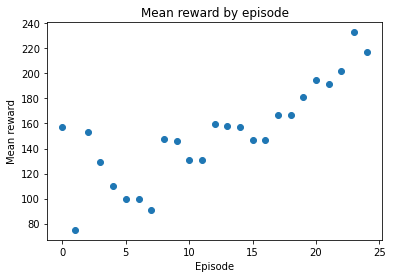

In [29]:
# Get the mean reward data back from the pickled array
# open a handle to the pickle file in read bytes mode. Use with so that we don't have to call the close function
with open('data/SpaceInvadersRewards.pkl', 'rb') as f:
    # use pickle to read back the data into the array
    mean_reward = pickle.load(f)

# graph the data. Use the list, range and len functions chained together to create the index
plt.scatter(list(range(len(mean_reward))), mean_reward)
# label the axes
plt.xlabel('Episode')
plt.ylabel('Mean reward')
plt.title('Mean reward by episode')
plt.show()

In [32]:
# Video of the agent playing Space Invaders
total_reward = 0
done = False
obs = env.reset()

# store the data for the video
scene = []
total_rewards = []

while not done:
    # work out the next action to take
    action = trainer.compute_single_action(obs)
    # take the next action
    obs, reward, done, _ = env.step(action)
    # add to the episode reward
    total_reward += reward
    total_rewards.append(total_reward)
    # get the render of the scene and append to the array
    scene.append(env.render(mode="rgb_array"))

# using code from Computer vision lab 5, animation
fig, ax = plt.subplots()

def frame_from_agent(i: int):
    """Render a frame of the video"""
    # wipe the last frame
    ax.clear()
    # get rid of the axis labels
    ax.axis('off')
    # render the image
    plot = ax.imshow(scene[i])
    # show the current total reward
    ax.set_title(f"Reward: {total_rewards[i]}")
    return plot
# build the video
anim = animation.FuncAnimation(fig, frame_from_agent, frames=len(scene))

# set the path to the ffmpeg program (install it using apt-get install ffmpeg, then use which ffmpeg to get where it installed to)
plt.rcParams['animation.ffmpeg_path'] = '/usr/bin/ffmpeg'

writervideo = animation.FFMpegWriter(fps=30) # from https://www.geeksforgeeks.org/how-to-save-matplotlib-animation/

anim.save('videos/SpaceInvaders.mp4', writer=writervideo)

# dispose of the graph object
plt.close()
# show the video
anim